**Table of Contents:**
---
[Dataset Creation and Preparation](#dataset_creation)

[Creating Model](#creating_model)

[Generating image before training](#generating)

[Training](#training)

[After training](#after_training)

**Importing libraries and packages**

In [2]:
import os
import glob
import pandas as pd
from PIL import Image
from tqdm import tqdm
pd.set_option('display.max_columns', None)  # Show all columns
pd.set_option('display.max_colwidth', None) # Do not truncate column content
from IPython.display import display
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import datetime
import time
Image.MAX_IMAGE_PIXELS = None
import tensorflow_io as tfio

In [2]:
# Check if GPUs are available
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        # Enable memory growth for each GPU
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        print("Memory growth enabled for GPUs")
    except RuntimeError as e:
        # Memory growth must be set before GPUs have been initialized
        print(e)

Memory growth enabled for GPUs


# Dataset Creation and Preparation <a name="dataset_creation"></a>

**Datasets used:**

**[Top 100 Hubble Telescope Images](https://www.kaggle.com/datasets/redwankarimsony/top-100-hubble-telescope-images)**

**[ESA Hubble Images](https://www.kaggle.com/datasets/subhamshome/esa-hubble-images-3-classes)**

**[SpaceNet: A Comprehensive Astronomical Dataset](https://www.kaggle.com/datasets/razaimam45/spacenet-an-optimally-distributed-astronomy-data/data)**

## Getting Image paths 

### Step 1: Get all image and TIF file paths from the datasets


In [3]:
datasets = {
    "Top 100 Hubble Telescope Images": "/kaggle/input/top-100-hubble-telescope-images",
    "ESA Hubble Images": "/kaggle/input/esa-hubble-images-3-classes",
    "SpaceNet": "/kaggle/input/spacenet-an-optimally-distributed-astronomy-data/SpaceNet.FLARE.imam_alam"
}

In [8]:

image_extensions = ['*.jpg', '*.jpeg', '*.png', '*.tif', '*.tiff']

all_image_paths = []

for dataset_name, dataset_path in datasets.items():
    for ext in image_extensions:
        all_image_paths.extend(glob.glob(os.path.join(dataset_path, '**', ext), recursive=True))


### Step 2: Check for corrupted files

In [6]:
valid_image_paths = []
corrupted_count = 0
Image.MAX_IMAGE_PIXELS = None

for image_path in tqdm(all_image_paths,desc="Verifying Images"):
    try:
        with Image.open(image_path) as img:
            img.verify()  # Verify that this is a valid image
        valid_image_paths.append(image_path)
    except (IOError, SyntaxError, Image.DecompressionBombError):
        corrupted_count += 1

Verifying Images: 100%|██████████| 13608/13608 [07:43<00:00, 29.33it/s] 

total corrupted images: 4645


### Step 3: Save the valid file paths

In [7]:
valid_image_paths_df = pd.DataFrame(valid_image_paths, columns=['file_path'])
valid_image_paths_df.to_csv('valid_image_paths.csv', index=False)

print(f"Total number of corrupted or oversized files: {corrupted_count}")
print(f"Valid image paths have been saved to 'valid_image_paths.csv'.")

Total number of corrupted or oversized files: 4645
Valid image paths have been saved to 'valid_image_paths.csv'.


In [4]:
valid_image_paths_df = pd.read_csv('valid_image_paths.csv')

# Function to extract the folder name
def get_folder_name(file_path):
    # Get the directory path (excluding the file name)
    directory_path = os.path.dirname(file_path)
    # Get the folder name (the last part of the directory path)
    folder_name = os.path.basename(directory_path)
    return folder_name

# Extract the dataset name from the file path
def get_dataset_name(file_path):
    for dataset_name, dataset_path in datasets.items():
        if file_path.startswith(dataset_path):
            return dataset_name
    return "Unknown"

# Apply the function to create a new column with dataset names
valid_image_paths_df['dataset_name'] = valid_image_paths_df['file_path'].apply(get_dataset_name)
valid_image_paths_df['folder_name'] = valid_image_paths_df['file_path'].apply(get_folder_name)

# Group by dataset and folder, then count the number of valid images
valid_image_paths_grouped = valid_image_paths_df.groupby(['dataset_name', 'folder_name']).size().reset_index(name='valid_image_count')
display(valid_image_paths_grouped)

,dataset_name,folder_name,valid_image_count
0,ESA Hubble Images,esa-hubble-images-3-classes,685
1,SpaceNet,asteroid,283
2,SpaceNet,black hole,656
3,SpaceNet,comet,416
4,SpaceNet,constellation,1552
5,SpaceNet,galaxy,2608
6,SpaceNet,nebula,1192
7,SpaceNet,planet,1472
8,Top 100 Hubble Telescope Images,top-100-hubble-telescope-images,99


In [6]:
len(valid_image_paths_df)

8963

## preprocessing on random image(for experimentation purpose)

In [4]:
sample_path = valid_image_paths_df.loc[np.random.randint(len(valid_image_paths_df))]
sample_path['file_path']

'/kaggle/input/spacenet-an-optimally-distributed-astronomy-data/SpaceNet.FLARE.imam_alam/nebula/nebula_page_2_image_8_aug2_SwinIR_large.png'

### Checking Image properties

Image shape: (2048, 2048, 3)
Image data type: uint8
Pixel value range: 0 to 255
Image is RGB color


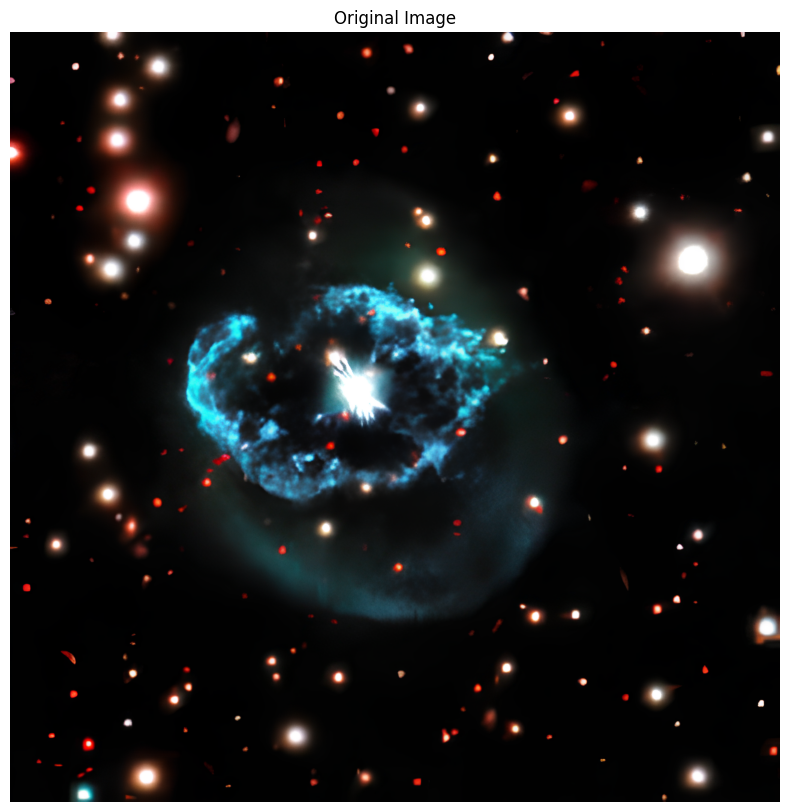

Red channel - Min: 0, Max: 255
Green channel - Min: 0, Max: 255
Blue channel - Min: 0, Max: 255


In [5]:
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

def check_and_display_image(file_path):
    # Open the image
    with Image.open(file_path) as img:
        # Convert to numpy array
        img_array = np.array(img)
        
        # Check image properties
        print(f"Image shape: {img_array.shape}")
        print(f"Image data type: {img_array.dtype}")
        print(f"Pixel value range: {img_array.min()} to {img_array.max()}")
        
        # Check if image is grayscale or color
        if len(img_array.shape) == 2 or (len(img_array.shape) == 3 and img_array.shape[2] == 1):
            print("Image is grayscale")
        elif len(img_array.shape) == 3 and img_array.shape[2] == 3:
            print("Image is RGB color")
        elif len(img_array.shape) == 3 and img_array.shape[2] == 4:
            print("Image is RGBA color (includes alpha channel)")
        
        # Display the image
        plt.figure(figsize=(10, 10))
        plt.imshow(img_array)
        plt.axis('off')
        plt.title('Original Image')
        plt.show()
        
        return img_array


original_img = check_and_display_image(sample_path['file_path'])

# If you want to check specific channels (for RGB images)
if len(original_img.shape) == 3 and original_img.shape[2] == 3:
    for i, color in enumerate(['Red', 'Green', 'Blue']):
        channel = original_img[:,:,i]
        print(f"{color} channel - Min: {channel.min()}, Max: {channel.max()}")

### preprocessed image <a name="preprocessed_image"></a>

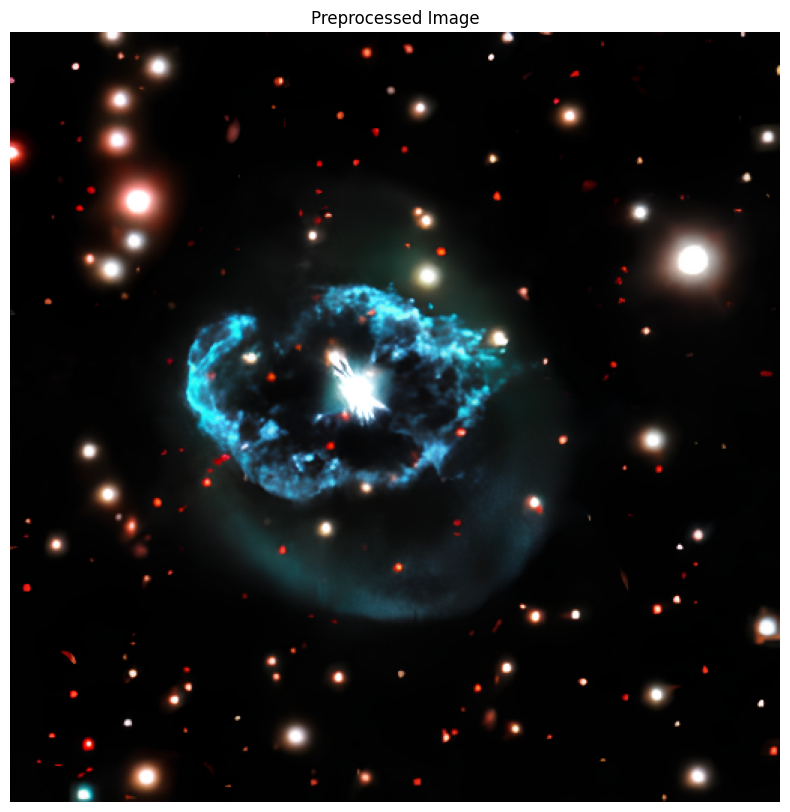

Preprocessed image shape: (512, 512, 3)
Pixel value range: 0.0 to 1.0


In [6]:
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
import tensorflow as tf

def preprocess_and_display_image(file_path, resize_dim=(512, 512)):
    # Open the image
    with Image.open(file_path) as img:
        # Convert to RGB format
        img = img.convert('RGB')
        
        # Convert to numpy array
        img_array = np.array(img)
        
        # Convert to TensorFlow tensor
        img_tensor = tf.convert_to_tensor(img_array)
        
        # Add batch dimension
        img_tensor = tf.expand_dims(img_tensor, 0)
        
        # Resize with padding
        img_resized = tf.image.resize_with_pad(img_tensor, resize_dim[0], resize_dim[1],method=tf.image.ResizeMethod.BILINEAR)
        
        # Remove batch dimension
        img_resized = tf.squeeze(img_resized)
        
        # Normalize to [0, 1]
        img_normalized = tf.cast(img_resized, tf.float32) / 255.0
        
        # Convert back to numpy for display
        img_display = img_normalized.numpy()
        
        # Display the image
        plt.figure(figsize=(10,10))
        plt.imshow(img_display)
        plt.axis('off')
        plt.title('Preprocessed Image')
        plt.show()
        
        return img_normalized


preprocessed_img = preprocess_and_display_image(sample_path['file_path'])

print(f"Preprocessed image shape: {preprocessed_img.shape}")
print(f"Pixel value range: {tf.reduce_min(preprocessed_img).numpy()} to {tf.reduce_max(preprocessed_img).numpy()}")

### Greyscale Converion

for this task, i will first Convert to Grayscale then Normalize both the color image and greyscale image

- Pros: Preserves the original relationship between color channels during grayscale conversion.
- Cons: Might work with larger integer values before normalization.

Color image shape: (512, 512, 3)
Grayscale image shape: (512, 512, 1)
Color image pixel range: 0.000000 to 1.000000
Grayscale image pixel range: 0.000000 to 1.000000


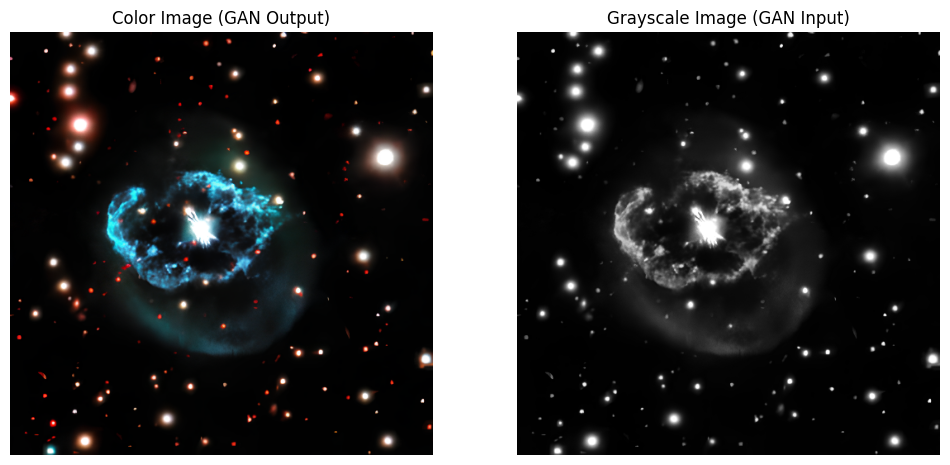

In [7]:
def preprocess_image(file_path, resize_dim=(512, 512)):
    # Open the image
    with Image.open(file_path) as img:
        # Convert to RGB format
        img = img.convert('RGB')
        
        # Convert to numpy array
        img_array = np.array(img)
        
        # Convert to TensorFlow tensor
        img_tensor = tf.convert_to_tensor(img_array)
        
        # Add batch dimension
        img_tensor = tf.expand_dims(img_tensor, 0)
        
        # Resize with padding
        img_resized = tf.image.resize_with_pad(img_tensor, resize_dim[0], resize_dim[1],method=tf.image.ResizeMethod.BILINEAR)
        
        # Remove batch dimension
        img_resized = tf.squeeze(img_resized)  # for displaying using plt, will give error if not removed that extra dimension
    
        return img_resized


def normalize_image(image, target_range=(0, 1)):
    """Normalize image to target range."""
    min_val = tf.reduce_min(image)
    max_val = tf.reduce_max(image)
    normalized = (image - min_val) / (max_val - min_val)
    return normalized * (target_range[1] - target_range[0]) + target_range[0]

def display_images(color, gray):
    plt.figure(figsize=(12, 6))
    
    plt.subplot(1, 2, 1)
    plt.imshow(color)
    plt.axis('off')
    plt.title('Color Image (GAN Output)')
    
    plt.subplot(1, 2, 2)
    plt.imshow(tf.squeeze(gray), cmap='gray')
    plt.axis('off')
    plt.title('Grayscale Image (GAN Input)')
    
    plt.show()


# Preprocess the image
img = preprocess_image(sample_path['file_path'])

gray_img = tf.image.rgb_to_grayscale(img)

# Normalize both color and grayscale images
color_img = normalize_image(img)
gray_img = normalize_image(gray_img)

print(f"Color image shape: {color_img.shape}")
print(f"Grayscale image shape: {gray_img.shape}")
print(f"Color image pixel range: {tf.reduce_min(color_img).numpy():.6f} to {tf.reduce_max(color_img).numpy():.6f}")
print(f"Grayscale image pixel range: {tf.reduce_min(gray_img).numpy():.6f} to {tf.reduce_max(gray_img).numpy():.6f}")

display_images(color_img, gray_img)

**Reference: [Colorizing black & white images with U-Net and conditional GAN — A Tutorial](https://towardsdatascience.com/colorizing-black-white-images-with-u-net-and-conditional-gan-a-tutorial-81b2df111cd8)**

**In all papers I studied and all codes I checked out on colorization on GitHub, people use L*a*b color space instead of RGB to train the models. There are a couple of reasons for this choice but I’ll give you an intuition of why we make this choice. To train a model for colorization, we should give it a grayscale image and hope that it will make it colorful. When using L*a*b, we can give the L channel to the model (which is the grayscale image) and want it to predict the other two channels (*a, *b) and after its prediction, we concatenate all the channels and we get our colorful image. But if you use RGB, you have to first convert your image to grayscale, feed the grayscale image to the model and hope it will predict 3 numbers for you which is a way more difficult and unstable task due to the many more possible combinations of 3 numbers compared to two numbers. If we assume we have 256 choices (in a 8-bit unsigned integer image this is the real number of choices) for each number, predicting the three numbers for each of the pixels is choosing between 256³ combinations which is more than 16 million choices, but when predicting two numbers we have about 65000 choices (actually, we are not going to wildly choose these numbers like a classification task and I just wrote these numbers to give you an intuition).**

Image shape after resizing: (512, 512, 3)
L channel shape: (512, 512)
a* channel shape: (512, 512)
b* channel shape: (512, 512)
L channel range: -1.000000 to 1.000000
a* channel range: -0.370300 to 0.618071
b* channel range: -0.278828 to 0.548464


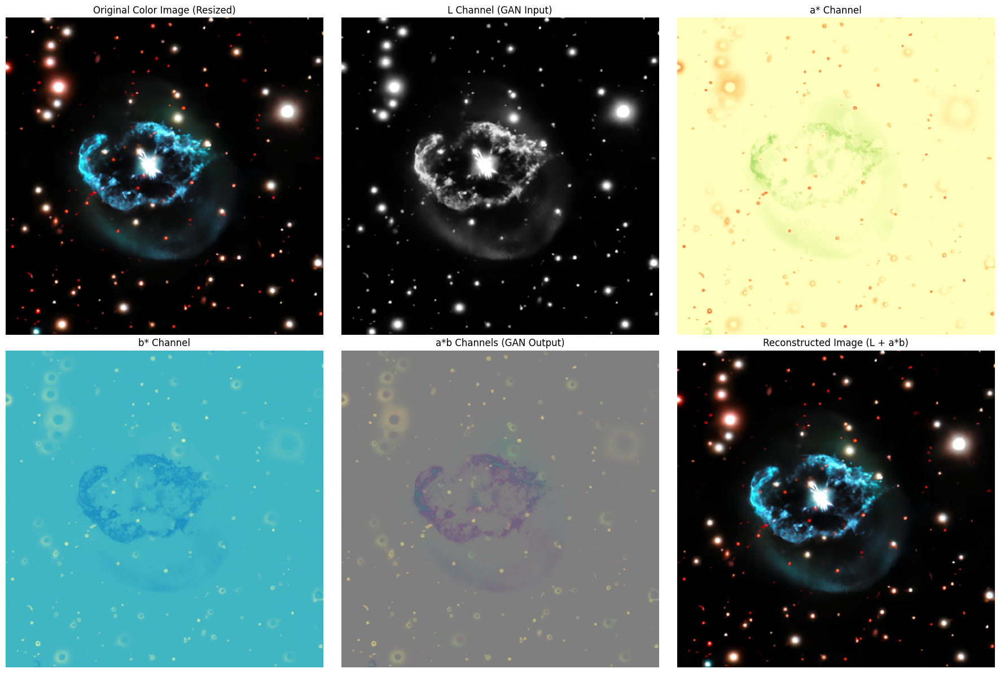

In [10]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from skimage import color
import tensorflow_io as tfio


def preprocess_image(file_path, resize_dim=(512, 512)):
    with Image.open(file_path) as img:
        img = img.convert('RGB').resize(resize_dim, Image.BILINEAR)
        img_array = np.array(img)
        lab_img = color.rgb2lab(img_array)
        
        l_chan = lab_img[:,:,0]
        a_chan = lab_img[:,:,1]
        b_chan = lab_img[:,:,2]
        
        # Normalize to [-1, 1]
        l_norm = l_chan / 50.0 - 1.0  # L is in range [0, 100]
        a_norm = a_chan / 128.0  # a is in range [-128, 127]
        b_norm = b_chan / 128.0  # b is in range [-128, 127]
        
        return l_norm, a_norm, b_norm, lab_img

def display_lab_channels_and_reconstructions(l_chan, a_chan, b_chan, lab_img):
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    
    axes[0, 0].imshow(color.lab2rgb(lab_img))
    axes[0, 0].set_title('Original Color Image (Resized)')
    axes[0, 0].axis('off')
    
    axes[0, 1].imshow(l_chan, cmap='gray', vmin=-1, vmax=1)
    axes[0, 1].set_title('L Channel (GAN Input)')
    axes[0, 1].axis('off')
    
    axes[0, 2].imshow(a_chan, cmap='RdYlGn_r', vmin=-1, vmax=1)
    axes[0, 2].set_title('a* Channel')
    axes[0, 2].axis('off')
    
    axes[1, 0].imshow(b_chan, cmap='YlGnBu_r', vmin=-1, vmax=1)
    axes[1, 0].set_title('b* Channel')
    axes[1, 0].axis('off')
    
    # In the display_lab_channels_and_reconstructions function:

    # Replace the existing ab_viz code with this:
    ab_viz = np.dstack([a_chan, b_chan, np.zeros_like(a_chan)])
    ab_viz = (ab_viz + 1) / 2  # Rescale from [-1, 1] to [0, 1]
    axes[1, 1].imshow(ab_viz)
    axes[1, 1].set_title('a*b Channels (GAN Output)')
    axes[1, 1].axis('off')
    # Check ranges after normalization
    assert np.all((-1.0 <= l_chan) & (l_chan <= 1.0)), "L channel normalization error"
    assert np.all((-1.0 <= a_chan) & (a_chan <= 1.0)), "a* channel normalization error"
    assert np.all((-1.0 <= b_chan) & (b_chan <= 1.0)), "b* channel normalization error"
    # Reconstruct image
    l_reconstruct = (l_chan + 1.0) * 50.0
    a_reconstruct = a_chan * 128.0
    b_reconstruct = b_chan * 128.0
    assert np.all((0 <= l_reconstruct) & (l_reconstruct <= 100)), "L channel denormalization error"
    assert np.all((-128 <= a_reconstruct) & (a_reconstruct <= 127)), "a* channel denormalization error"
    assert np.all((-128 <= b_reconstruct) & (b_reconstruct <= 127)), "b* channel denormalization error"

    lab_stack = np.stack([l_reconstruct, a_reconstruct, b_reconstruct], axis=-1)
    axes[1, 2].imshow(color.lab2rgb(lab_stack))
    axes[1, 2].set_title('Reconstructed Image (L + a*b)')
    axes[1, 2].axis('off')
    
    plt.tight_layout()
    plt.show()

# Usage
l_chan, a_chan, b_chan, lab_img = preprocess_image(sample_path['file_path'])
print(f"Image shape after resizing: {lab_img.shape}")
print(f"L channel shape: {l_chan.shape}")
print(f"a* channel shape: {a_chan.shape}")
print(f"b* channel shape: {b_chan.shape}")
print(f"L channel range: {np.min(l_chan):.6f} to {np.max(l_chan):.6f}")
print(f"a* channel range: {np.min(a_chan):.6f} to {np.max(a_chan):.6f}")
print(f"b* channel range: {np.min(b_chan):.6f} to {np.max(b_chan):.6f}")
display_lab_channels_and_reconstructions(l_chan, a_chan, b_chan, lab_img)

## Creating Dataset Pipeline

In [5]:
def dataset_pipeline(df, batch_size, target_size, shuffle=True, augment=False, cache=False, temp_dir=None):
    
    def load_and_preprocess_image(filepath):
        def _preprocess(image_path_tensor):
            image_path = image_path_tensor.numpy().decode('utf-8')
            with tf.io.gfile.GFile(image_path, 'rb') as file:
                img = Image.open(file).convert("RGB")
            img = np.array(img)
            return img

        # Load and resize image
        img = tf.py_function(_preprocess, [filepath], tf.uint8)
        img.set_shape((None, None, 3))
        img = tf.image.resize_with_pad(img, target_size[0], target_size[1], method=tf.image.ResizeMethod.BILINEAR)

        # Normalize RGB to [0, 1] for LAB conversion
        img_float = tf.cast(img, tf.float32) / 255.0

        # Convert RGB to LAB using TensorFlow I/O
        lab_img = tfio.experimental.color.rgb_to_lab(img_float)

        # Normalize LAB channels to [-1, 1]
        l_chan = lab_img[:,:,0] / 50.0 - 1.0  # L is in range [0, 100]
        a_chan = lab_img[:,:,1] / 128.0  # a is in range [-128, 127]
        b_chan = lab_img[:,:,2] / 128.0  # b is in range [-128, 127]

        # Create input (L) and target (ab) tensors
        input_image = tf.expand_dims(l_chan, axis=-1)
        target_image = tf.stack([a_chan, b_chan], axis=-1)

        return input_image, target_image
    def augment_image(x, y):
        if tf.random.uniform(()) > 0.5:
            x = tf.image.flip_left_right(x)
            y = tf.image.flip_left_right(y)
        if tf.random.uniform(()) > 0.5:
            x = tf.image.flip_up_down(x)
            y = tf.image.flip_up_down(y)
        if tf.random.uniform(()) > 0.5:
            x = tf.image.rot90(x)
            y = tf.image.rot90(y)
        return x, y

    filepaths = df['file_path'].values
    dataset = tf.data.Dataset.from_tensor_slices(filepaths)

    

    dataset = dataset.map(load_and_preprocess_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)

    if cache:
        if temp_dir is not None:
            dataset = dataset.cache(temp_dir)
        else:
            dataset = dataset.cache()
    if shuffle:
        dataset = dataset.shuffle(buffer_size=5000)
        
    if augment:
        dataset = dataset.map(augment_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)

    # Batch the dataset
    dataset = dataset.batch(batch_size)

    # Prefetch for performance
    dataset = dataset.prefetch(tf.data.experimental.AUTOTUNE)

    return dataset

In [6]:
batch_size_gpu=32
target_size=(224,224)
temp_dir = "/kaggle/temp"
os.makedirs(temp_dir, exist_ok=True)

### Splitting into train,dev dataset (will apply same dataset pipeline on all 2)

In [23]:
len(valid_image_paths_df)

8963

In [7]:
# First split: separate test set
train_val_df, test_df = train_test_split(valid_image_paths_df, test_size=0.05)

# Second split: separate dev set from remaining data
train_df, dev_df = train_test_split(valid_image_paths_df, test_size=0.1)

### Initializing the datasets

In [9]:
#if tf.config.list_physical_devices('GPU'):

train_dataset  = dataset_pipeline(train_df, batch_size_gpu, target_size, shuffle=True, augment=True, cache=True)
dev_dataset = dataset_pipeline(dev_df, batch_size_gpu, target_size, shuffle=False, augment=False, cache=True)
test_dataset = dataset_pipeline(test_df, batch_size_gpu, target_size, shuffle=False, augment=False, cache=False ,temp_dir="/kaggle/temp/test")
        


# Creating Model <a name="creating_model"></a>

## Generator Unet Architecture

In [10]:
!pip install segmentation_models
os.environ["SM_FRAMEWORK"] = "tf.keras" 
import segmentation_models as sm 
sm.set_framework('tf.keras')            # Use segmentation_models library and set the framework to TensorFlow's Keras
tf.keras.backend.set_image_data_format('channels_last')


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 kB 2.8 MB/s eta 0:00:00
Segmentation Models: using `tf.keras` framework.


In [10]:
# Enable mixed precision
#tf.keras.mixed_precision.set_global_policy('mixed_float16')

In [188]:
from tensorflow.keras.layers import Conv2D,Conv2DTranspose, BatchNormalization, Activation, Dropout, LeakyReLU, Input, concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam,AdamW
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping
from tensorflow.keras import backend as K
from tensorflow.keras.regularizers import l2
from tensorflow.keras.losses import CategoricalCrossentropy, BinaryCrossentropy


def create_model():
    # Parameters
    BACKBONE = 'efficientnetb4'
    input_shape = (target_size[0], target_size[1], 1)
    n_classes = 2
    activation = 'tanh'
    
    # Define the input layer with 1 channel for grayscale images
    inputs = Input(shape=input_shape)
    
    # Replicate the grayscale channel 3 times to match the pre-trained model input
    x = tf.keras.layers.Concatenate()([inputs, inputs, inputs])
    
    model = sm.Unet(
        backbone_name=BACKBONE,
        input_shape=(target_size[0], target_size[1], 3), # Update input_shape to 3 channels
        classes=n_classes,
        activation=activation,
        encoder_weights='imagenet' # Use pre-trained weights
    )
    
    # Create the final model
    model = Model(inputs, model(x))
    
    return model





### Generator Loss

In [19]:
LAMBDA = 100
loss_object = BinaryCrossentropy(from_logits=True)

def generator_loss(disc_generated_output, gen_output, target):
    
    gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

    # Mean absolute error
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

    total_gen_loss = gan_loss + (LAMBDA * l1_loss)

    return total_gen_loss, gan_loss, l1_loss

## Discriminator(PatchGan)

In [20]:
def downsample(filters, size, apply_batchnorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

    if apply_batchnorm:
        result.add(tf.keras.layers.BatchNormalization())

    result.add(tf.keras.layers.LeakyReLU())

    return result

In [39]:
#used this in early stages with conditional gan, this contains batch norm so not preferred with WGANs-gp
def base_Discriminator():
    
    initializer = tf.random_normal_initializer(0., 0.02)
    #inp expects 1 channel while tar expects 3
    inp = tf.keras.layers.Input(shape=[target_size[0], target_size[1], 1], name='input_image')
    tar = tf.keras.layers.Input(shape=[target_size[0], target_size[1], 2], name='target_image')

    x = tf.keras.layers.concatenate([inp, tar])  

    down1 = downsample(64, 4, False)(x) 
    down2 = downsample(128, 4)(down1)  
    down3 = downsample(256, 4)(down2)  

    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)  
    conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                    kernel_initializer=initializer,
                                    use_bias=False)(zero_pad1) 

    batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

    leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)  

    last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                    kernel_initializer=initializer)(zero_pad2)

    return tf.keras.Model(inputs=[inp, tar], outputs=last)

In [189]:
def build_discriminator():
    input_l = tf.keras.layers.Input(shape=(target_size[0], target_size[1], 1))
    input_ab = tf.keras.layers.Input(shape=(target_size[0], target_size[1], 2))
    x = tf.keras.layers.Concatenate()([input_l, input_ab])

    x = tf.keras.layers.Conv2D(64, 4, strides=2, padding='same')(x)
    x = tf.keras.layers.LeakyReLU(negative_slope=0.01)(x)

    x = tf.keras.layers.Conv2D(128, 4, strides=2, padding='same')(x)
    x = tf.keras.layers.LayerNormalization()(x)
    x = tf.keras.layers.LeakyReLU(negative_slope=0.01)(x)

    x = tf.keras.layers.Conv2D(256, 4, strides=2, padding='same')(x)
    x = tf.keras.layers.LayerNormalization()(x)
    x = tf.keras.layers.LeakyReLU(negative_slope=0.01)(x)

    x = tf.keras.layers.Conv2D(512, 4, strides=1, padding='same')(x)
    x = tf.keras.layers.LayerNormalization()(x)
    x = tf.keras.layers.LeakyReLU(negative_slope=0.01)(x)

    x = tf.keras.layers.Conv2D(1, 4, strides=1, padding='same')(x)

    return tf.keras.Model(inputs=[input_l, input_ab], outputs=x)



### Discriminator Loss

In [13]:
def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

    generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

    total_disc_loss = real_loss + generated_loss

    return total_disc_loss

## Optimizer and checkpoint

In [13]:
generator_optimizer = AdamW(2e-5, beta_1=0, weight_decay=1e-5)
discriminator_optimizer = AdamW(2e-5, beta_1=0, weight_decay=1e-4)

In [190]:
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001, beta_1=0, beta_2=0.9)
# AdamW optimizer for the generator
generator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001, beta_1=0, beta_2=0.9)

In [13]:
# AdamW optimizer for the generator
generator_optimizer = tf.keras.optimizers.AdamW(
    learning_rate=1e-4,
    weight_decay=1e-4,
    beta_1=0,
    beta_2=0.999,
    epsilon=1e-8
)

# AdamW optimizer for the discriminator
discriminator_optimizer = tf.keras.optimizers.AdamW(
    learning_rate=1e-4,
    weight_decay=1e-4,
    beta_1=0,
    beta_2=0.999,
    epsilon=1e-8
)


#### Initializing the models 

In [187]:
#from keras import backend as K
#K.clear_session()

In [191]:
#if tf.config.list_physical_devices('GPU'):
    
generator= create_model()
discriminator = build_discriminator()



71892840/71892840 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


#### Model's structure

In [192]:
generator.summary()

Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate         │ (None, 224, 224,  │          0 │ input_layer[0][0… │
│ (Concatenate)       │ 3)                │            │ input_layer[0][0… │
│                     │                   │            │ input_layer[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ functional_1        │ (None, 224, 224,  │ 25,735,162 │ concatenate[0][0] │
│ (Functional)        │ 2)                │            │                   │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 25,735,162 (98.17 MB)

 Trainable params: 25,607,978 (97.69 MB)

 Non-trainable params: 127,184 (496.81 KB)

In [193]:
discriminator.summary()

Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ input_layer_3       │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 2)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate_1       │ (None, 224, 224,  │          0 │ input_layer_2[0]… │
│ (Concatenate)       │ 3)                │            │ input_layer_3[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 112, 112,  │      3,136 │ concatenate_1[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu         │ (None, 112, 112,  │          0 │ conv2d[0][0]      │
│ (LeakyReLU)         │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 56, 56,    │    131,200 │ leaky_re_lu[0][0] │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ layer_normalization │ (None, 56, 56,    │        256 │ conv2d_1[0][0]    │
│ (LayerNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_1       │ (None, 56, 56,    │          0 │ layer_normalizat… │
│ (LeakyReLU)         │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 28, 28,    │    524,544 │ leaky_re_lu_1[0]… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ layer_normalizatio… │ (None, 28, 28,    │        512 │ conv2d_2[0][0]    │
│ (LayerNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_2       │ (None, 28, 28,    │          0 │ layer_normalizat… │
│ (LeakyReLU)         │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 28, 28,    │  2,097,664 │ leaky_re_lu_2[0]… │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ layer_normalizatio… │ (None, 28, 28,    │      1,024 │ conv2d_3[0][0]    │
│ (LayerNormalizatio… │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ leaky_re_lu_3       │ (None, 28, 28,    │          0 │ layer_normalizat… │
│ (LeakyReLU)         │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 28, 28, 1) │      8,193 │ leaky_re_lu_3[0]… │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 2,766,529 (10.55 MB)

 Trainable params: 2,766,529 (10.55 MB)

 Non-trainable params: 0 (0.00 B)

#### plotting models

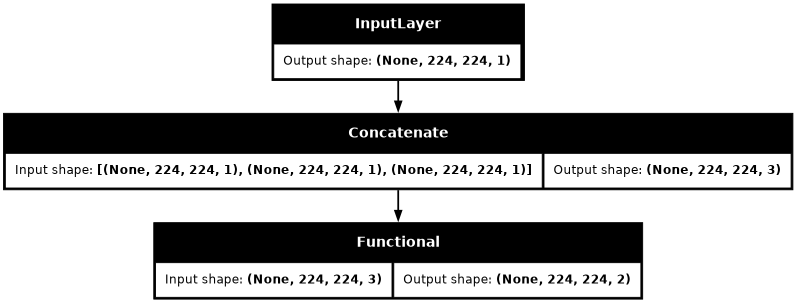

In [194]:
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

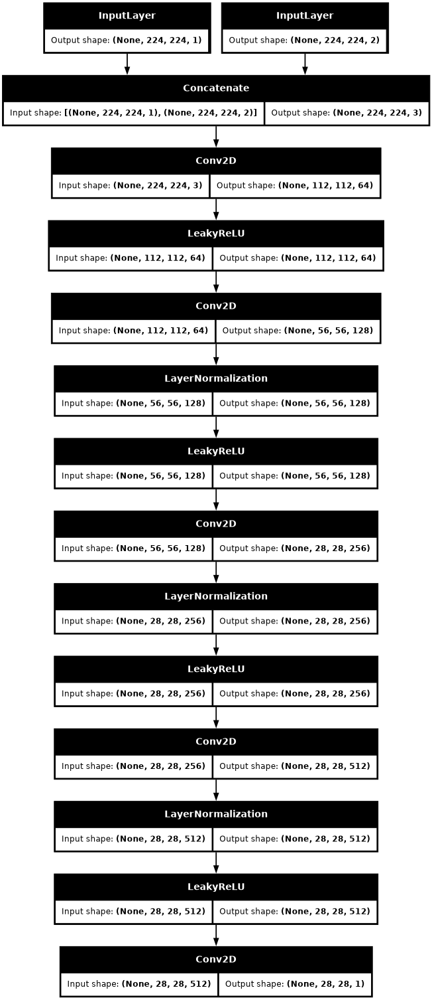

In [195]:
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

# Generating image before training <a name="generating"></a>

In [196]:
def inspect_dataset_shapes(dataset):
    iterator = iter(dataset)
    try:
        example_input, example_target = next(iterator)
        print("Input shape:", example_input.shape)
        print("Target shape:", example_target.shape)
    except StopIteration:
        print("Dataset is empty")
def inspect_model_shapes(model):
    print("Model input shape:", model.input_shape)
    print("Model output shape:", model.output_shape)

# Usage
inspect_model_shapes(generator)
# Usage
inspect_dataset_shapes(test_dataset)

Model input shape: (None, 224, 224, 1)
Model output shape: (None, 224, 224, 2)
Input shape: (32, 224, 224, 1)
Target shape: (32, 224, 224, 2)


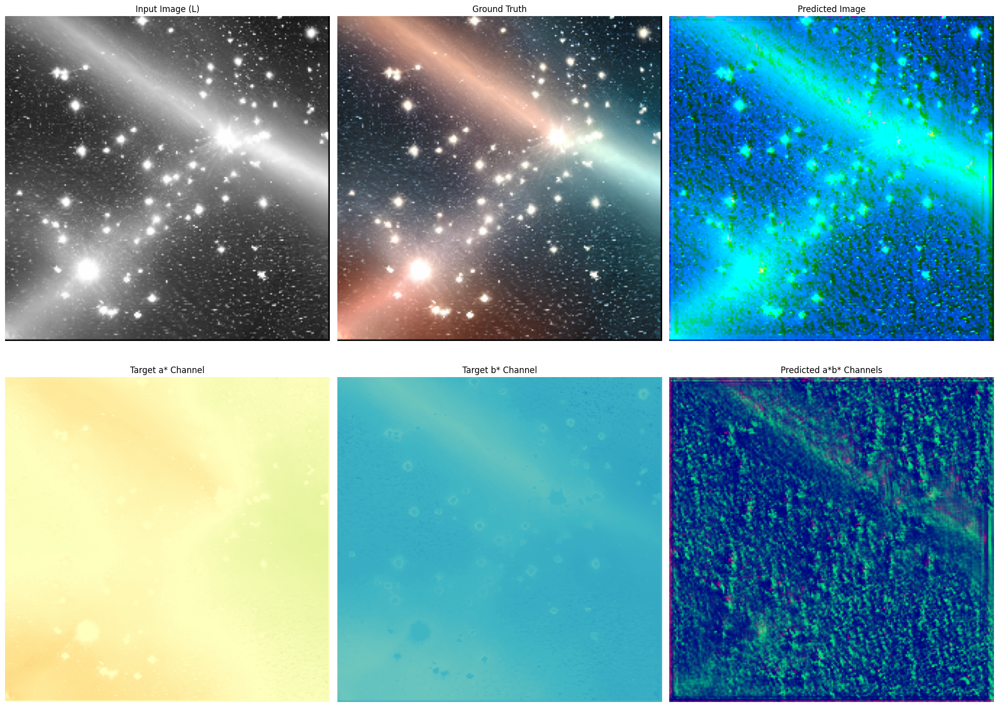

In [197]:
import tensorflow as tf

import matplotlib.pyplot as plt
import numpy as np

# Function to convert LAB to RGB using TensorFlow I/O
def lab_to_rgb(l_chan, ab_chan):
    # Ensure L channel is 4D (including batch dimension)
    if len(l_chan.shape) == 3:  # If single image, add batch dimension
        l_chan = tf.expand_dims(l_chan, axis=0)
    if len(ab_chan.shape) == 3:  # If single image, add batch dimension
        ab_chan = tf.expand_dims(ab_chan, axis=0)
    
    # Denormalize channels
    l_denorm = (l_chan + 1) * 50  # L: [-1, 1] -> [0, 100]
    ab_denorm = ab_chan * 128     # a* and b*: [-1, 1] -> [-128, 127]
    
    # Combine channels
    lab_img = tf.concat([l_denorm, ab_denorm], axis=-1)

    # Convert LAB to RGB using TensorFlow I/O
    def convert_single_image(img):
        return tfio.experimental.color.lab_to_rgb(img)
    
    # Handle both batched and unbatched inputs
    if len(lab_img.shape) == 4:  # Batched input
        rgb_img = tf.map_fn(convert_single_image, lab_img, dtype=tf.float32)
    else:  # Single image
        rgb_img = convert_single_image(lab_img)
    
    return tf.clip_by_value(rgb_img, 0.0, 1.0)

def generate_images(model, test_input, tar):
    prediction = model(test_input, training=False)
    
    plt.figure(figsize=(20, 15))
    # Convert to RGB for display
    input_rgb = lab_to_rgb(test_input[0], tf.zeros_like(tar[0]))[0]  # Remove batch dimension
    target_rgb = lab_to_rgb(test_input[0], tar[0])[0]  # Remove batch dimension
    prediction_rgb = lab_to_rgb(test_input[0], prediction[0])[0]  # Remove batch dimension
    
    display_list = [input_rgb, target_rgb, prediction_rgb]
    title = ['Input Image (L)', 'Ground Truth', 'Predicted Image']
    
    for i in range(3):
        plt.subplot(2, 3, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i])
        plt.axis('off')
    
    # Display a* and b* channels
    plt.subplot(2, 3, 4)
    plt.title('Target a* Channel')
    plt.imshow(tar[0,:,:,0], cmap='RdYlGn_r', vmin=-1, vmax=1)
    plt.axis('off')
    
    plt.subplot(2, 3, 5)
    plt.title('Target b* Channel')
    plt.imshow(tar[0,:,:,1], cmap='YlGnBu_r', vmin=-1, vmax=1)
    plt.axis('off')
    
    plt.subplot(2, 3, 6)
    plt.title('Predicted a*b* Channels')
    ab_viz = tf.concat([prediction[0], tf.zeros_like(prediction[0,:,:,:1])], axis=-1)
    ab_viz = (ab_viz + 1) / 2  # Rescale to [0, 1] for visualization
    plt.imshow(ab_viz)
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()

# Usage
for example_input, example_target in test_dataset.take(1):
    generate_images(generator, example_input, example_target)

# Training <a name="training"></a>

**Note: First i tried normal and conditional GANs but experienced heavy mode collapse so now shifting to WGANs-gp(grradient penalty)**

will follow this image for training process 

**Reference: [WGANs-gp(paper)](https://arxiv.org/abs/1704.00028)**
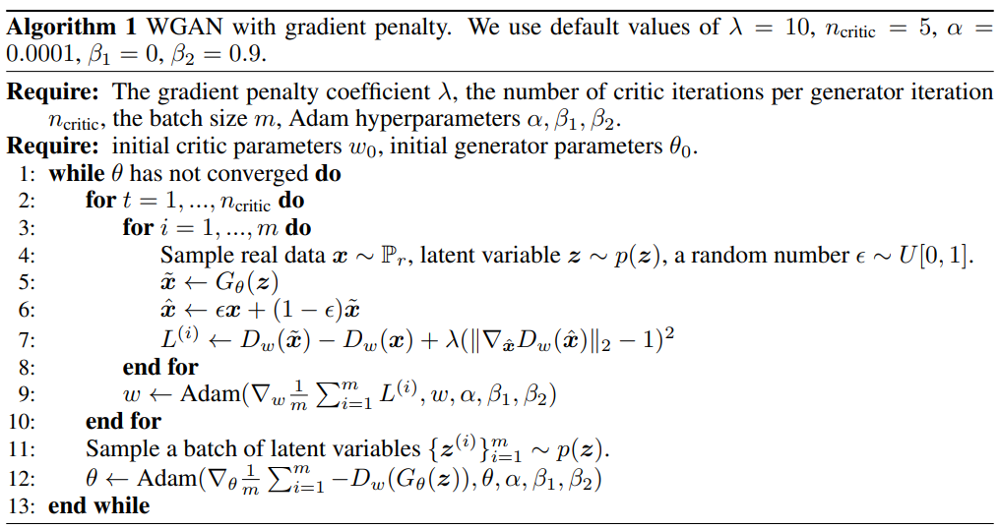


In the context of training Wasserstein GANs with gradient penalty (WGAN-GP), the objective is slightly different from traditional GANs. Here are the key points you want to focus on regarding the generator and discriminator losses:

Generator Loss: The goal for the generator in WGAN-GP is to minimize its own loss, which ideally should increase towards zero. However, unlike other GANs where the generator's loss is directly linked to fooling the discriminator, in WGAN-GP, the generator is more directly trying to minimize the Wasserstein distance between the real and generated distributions. So, seeing the generator loss increase (become less negative) suggests the generator is improving.But The generator loss is expected to go below 0. This indicates that the generator is effectively improving its ability to produce realistic data samples. Negative values suggest that the generator is generating outputs that the discriminator finds increasingly difficult to distinguish from real data.

Discriminator Loss: For the discriminator (often called the critic in WGANs), the goal is not to converge to zero but to oscillate or stabilize around a value that does not signify winning or losing. The discriminator in WGAN-GP is trained to enforce a 1-Lipschitz constraint and to provide useful gradients to the generator rather than to purely maximize its accuracy in distinguishing real from fake samples. Fluctuations around zero can be normal, as it reflects the ongoing tug-of-war between the generator getting better and the discriminator adapting to these improvements.
base version: (The discriminator loss should ideally hover around 0 but not be exactly 0. A loss of 0 would imply that the discriminator is perfectly distinguishing real from generated data, which is unrealistic in practice. Instead, the discriminator should show some fluctuation around 0, reflecting its ongoing challenge in differentiating between real and fake samples.)


Gradient Penalty (GP): This is a crucial component in WGAN-GP, ensuring that the discriminator's gradient norms are close to 1, which helps in enforcing the Lipschitz constraint. The GP values should ideally be low, indicating that the discriminator’s gradients do not violate the Lipschitz constraint by much.



In [26]:
from tqdm.notebook import tqdm


In [27]:
# Before the training loop, for caching
#takes around 20 min and as we are shuffling after caching, 
#for the first iteration of session when it creates and stores the cache, the progressbar will appear stuck
for _ in tqdm(train_dataset):
    pass


  0%|          | 0/253 [00:00<?, ?it/s]

In [14]:
# Define the PSNR function
def psnr(y_true, y_pred):
    # Assume pixel values are in the range [0, 1]
    max_pixel = 1.0
    # Calculate MSE
    mse = tf.reduce_mean(tf.square(y_true - y_pred))
    # Calculate PSNR using the formula: PSNR = 20 * log10(MAX) - 10 * log10(MSE)
    psnr = tf.image.psnr(y_true, y_pred, max_val=max_pixel)
    return psnr

In [15]:
def gradient_penalty(discriminator, real_l, real_ab, fake_ab):
    batch_size = tf.shape(real_l)[0]
    alpha = tf.random.uniform([batch_size, 1, 1, 1], 0.0, 1.0)
    interpolated_ab = real_ab * alpha + fake_ab * (1 - alpha)
    
    with tf.GradientTape() as gp_tape:
        gp_tape.watch(interpolated_ab)
        disc_interpolates = discriminator([real_l, interpolated_ab])
    
    grads = gp_tape.gradient(disc_interpolates, interpolated_ab)
    # Adjusting the reduction axes based on the shape of grads
    norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=list(range(1, len(grads.shape)))))
    gp = tf.reduce_mean((norm - 1.0) ** 2)
    return gp

In [16]:
@tf.function
def train_discriminator(input_l, target_ab):
    with tf.GradientTape() as disc_tape:
        gen_ab = generator(input_l, training=False)

        disc_real_output = discriminator([input_l, target_ab], training=True)
        disc_generated_output = discriminator([input_l, gen_ab], training=True)

        # Wasserstein loss
        disc_loss = tf.reduce_mean(disc_generated_output) - tf.reduce_mean(disc_real_output)

        # Gradient penalty
        gp = gradient_penalty(discriminator, input_l, target_ab, gen_ab)
        disc_loss += 10 * gp

    gradients = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    discriminator_optimizer.apply_gradients(zip(gradients, discriminator.trainable_variables))
    
    return disc_loss, gp

@tf.function
def train_generator(input_l, target_ab):
    with tf.GradientTape() as gen_tape:
        gen_ab = generator(input_l, training=True)
        disc_generated_output = discriminator([input_l, gen_ab], training=False)

        gen_gan_loss = -tf.reduce_mean(disc_generated_output)
        gen_l1_loss = tf.reduce_mean(tf.abs(target_ab - gen_ab))
        gen_total_loss = gen_gan_loss + (LAMBDA * gen_l1_loss)

    gradients = gen_tape.gradient(gen_total_loss, generator.trainable_variables)
    generator_optimizer.apply_gradients(zip(gradients, generator.trainable_variables))

    return gen_total_loss, gen_gan_loss, gen_l1_loss


def validate(generator, validation_dataset):
    psnr_values = []
    print("Validating...")
    for input_l, target_ab in validation_dataset:
        gen_ab = generator(input_l, training=False)
        gen_rgb = lab_to_rgb(input_l, gen_ab)
        target_rgb = lab_to_rgb(input_l, target_ab)
        psnr_value = tf.image.psnr(target_rgb, gen_rgb, max_val=1.0)
        psnr_values.append(tf.reduce_mean(psnr_value))
    return tf.reduce_mean(psnr_values)


In [17]:
def train_step(input_l, target_ab, step):
    # Train discriminator
    disc_loss, gp = train_discriminator(input_l, target_ab)
    
    # Train generator every 5th step
    if step % 3 == 0:
        gen_total_loss, gen_gan_loss, gen_l1_loss = train_generator(input_l, target_ab)
    else:
        gen_total_loss, gen_gan_loss, gen_l1_loss = None, None, None
    
    return disc_loss, gp, gen_total_loss, gen_gan_loss, gen_l1_loss


In [202]:
def fit(train_ds, test_ds, validation_dataset, EPOCHS):
    example_input, example_target = next(iter(test_ds.take(1)))
    step_counter = 0  # Initialize step counter

    for epoch in range(EPOCHS):
        start = time.time()
        clear_output(wait=True)
        if epoch%10==0:
            validation_psnr = validate(generator, validation_dataset)
            print(f"Validation PSNR: {validation_psnr:.4f}")
        generate_images(generator, example_input, example_target)

        # Use tqdm for progress bar
        progress_bar = tqdm(enumerate(train_ds), total=len(train_ds), desc=f"Epoch {epoch + 1}")
        
        for step, (input_l, target_ab) in progress_bar:
            step_counter += 1

            disc_loss, gp, gen_total_loss, gen_gan_loss, gen_l1_loss = train_step(input_l, target_ab, step_counter)

            if gen_total_loss is not None:
                # Calculate PSNR and update progress bar
                gen_ab = generator(input_l, training=False)
                gen_rgb = lab_to_rgb(input_l, gen_ab)
                target_rgb = lab_to_rgb(input_l, target_ab)
                psnr_value = tf.reduce_mean(tf.image.psnr(target_rgb, gen_rgb, max_val=1.0))
                
                if (step_counter ) % 5 == 0:
                    progress_bar.set_postfix(PSNR=psnr_value.numpy())
                if (step_counter ) % 25 == 0:
                    print(f"Epoch {epoch + 1}, Step {step + 1}, Gen Total Loss: {gen_total_loss:.4f}, "
                          f"Gen L1 Loss: {gen_l1_loss:.4f}, Disc Loss: {disc_loss:.4f}, GP: {gp:.4f}, "
                          f"PSNR: {psnr_value:.4f}")
                    
                    
        '''# Save the model periodically
        if (epoch + 1) % 2 == 0:
            generator.save(f'generator_epoch_{epoch + 1}.h5')
            discriminator.save(f'discriminator_epoch_{epoch + 1}.h5')'''
    
        

In [203]:
LAMBDA = 100

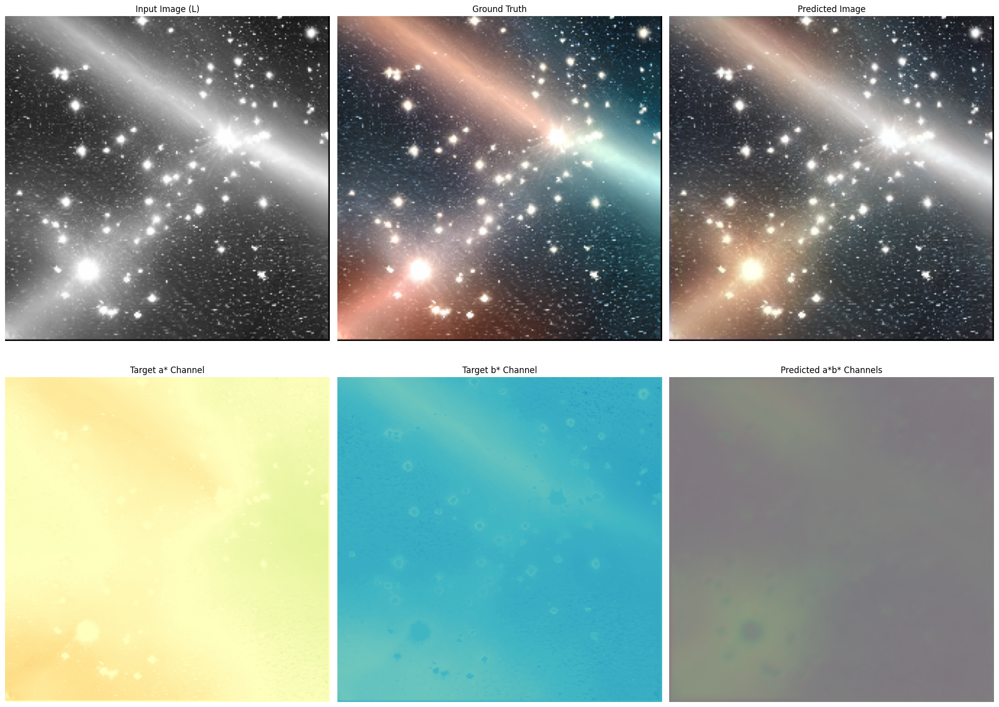

Epoch 3:   0%|          | 0/253 [00:00<?, ?it/s]

Epoch 3, Step 19, Gen Total Loss: 8.0830, Gen L1 Loss: 0.0470, Disc Loss: -0.0039, GP: 0.0002, PSNR: 27.9407
Epoch 3, Step 94, Gen Total Loss: 8.6465, Gen L1 Loss: 0.0521, Disc Loss: -0.0039, GP: 0.0001, PSNR: 27.2102


In [ ]:
from IPython.display import clear_output 
fit(train_dataset,test_dataset, dev_dataset, EPOCHS=20)

In [56]:
#!rm -rf /kaggle/working/generator_epoch_6.h5

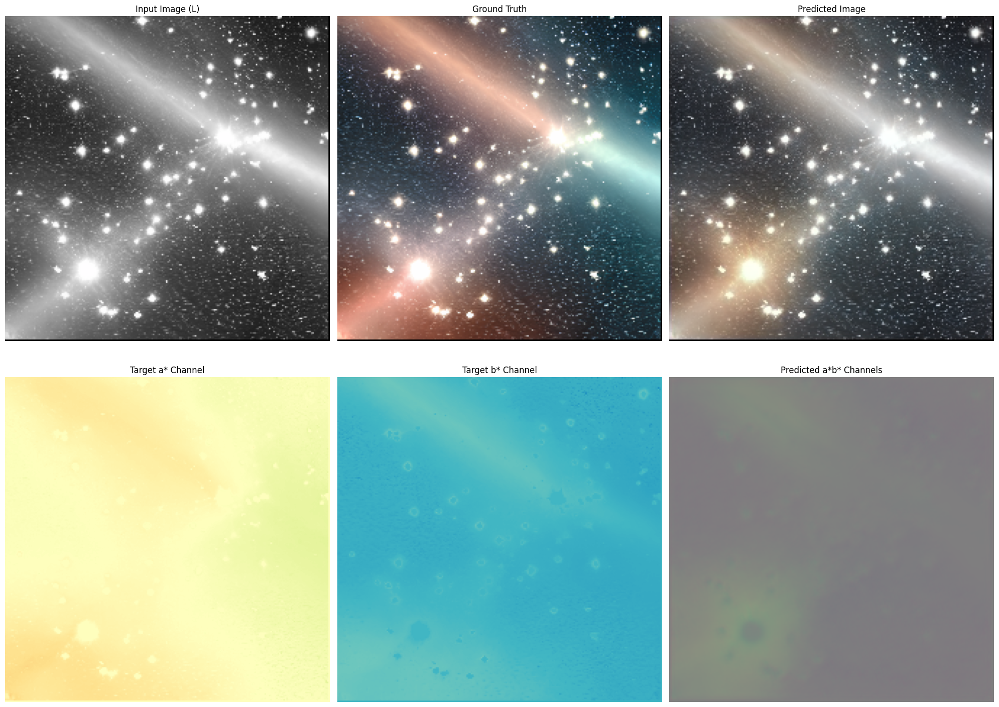

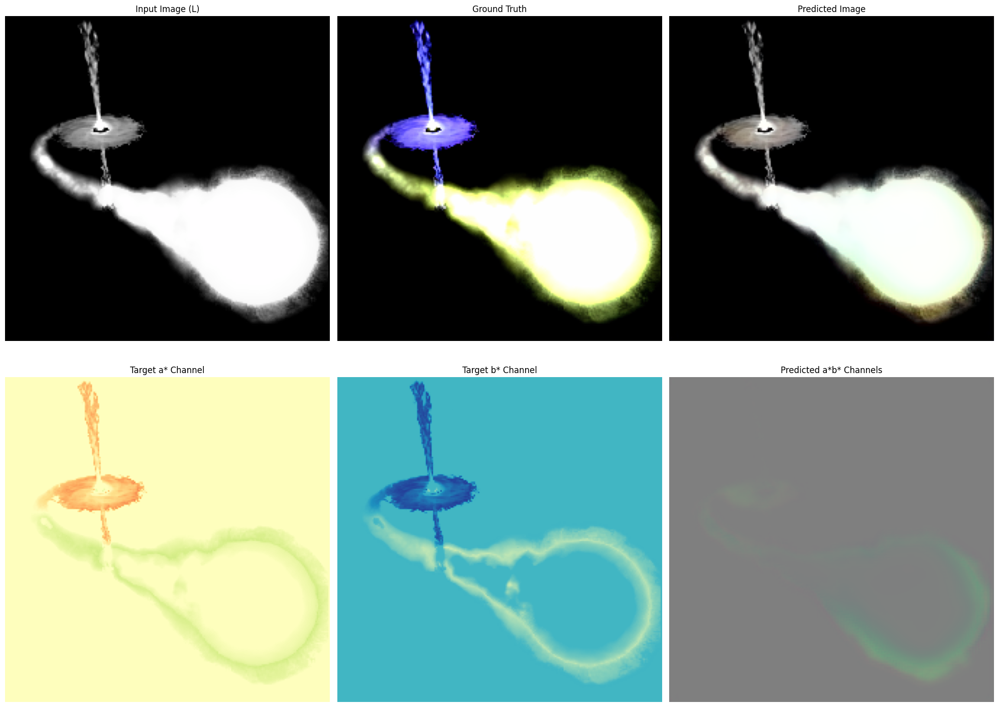

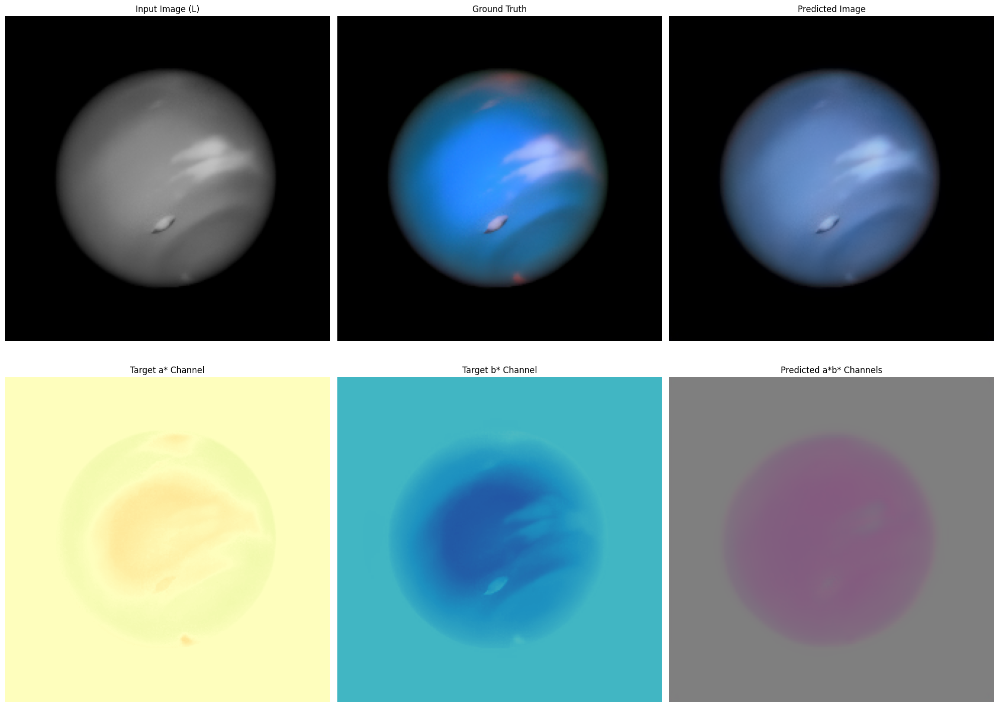

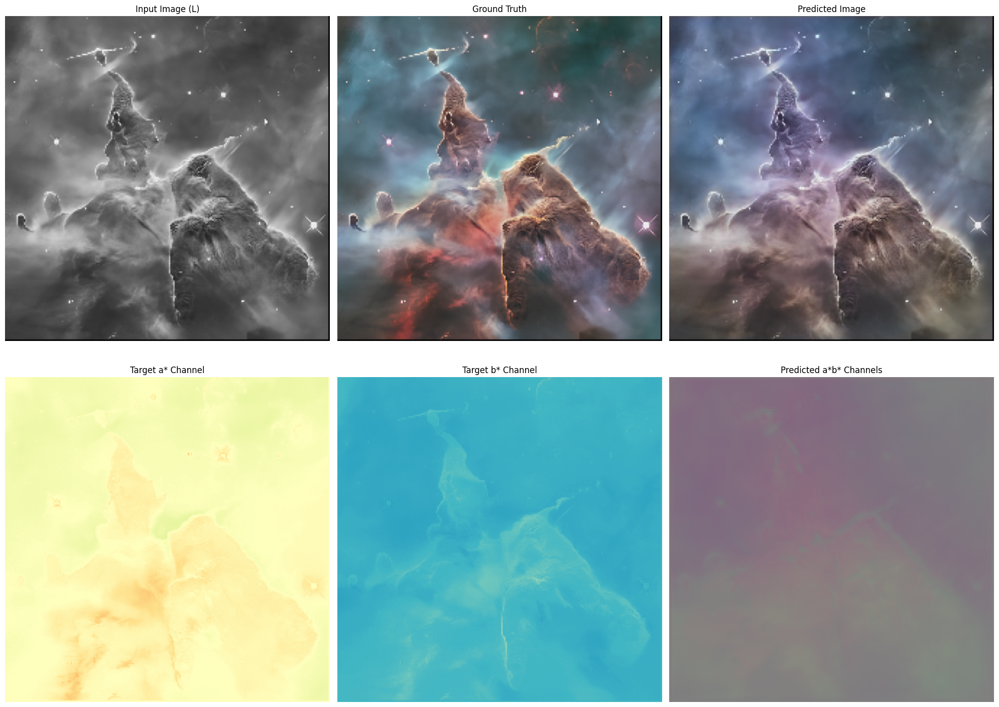

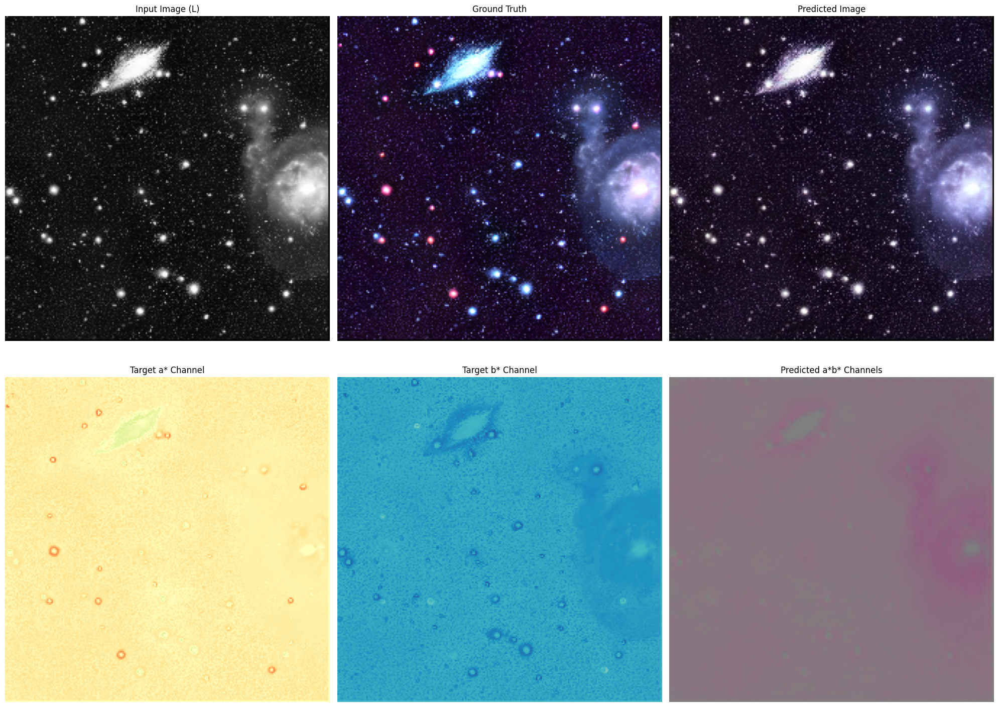

In [211]:
for inp, tar in test_dataset.take(5):
    generate_images(generator, inp, tar)

# After Training <a name="after_training"></a>

| Changes Made | Steps/Epochs | Train PSNR | Validation PSNR |
|--------------|--------------|------------|-----------------|
| ResNet34 backbone for UNet generator, complex discriminator with dropout | 15k steps | 24.2 | 21.4 |
| ResNet34 backbone for UNet generator, basic discriminator | 15k steps | 26.65 | 23.06 |
| WGANs-gp with L1 loss in generator (lambda=10) | 5 epochs | 28 | 25 (fluctuating) |
| Generator trained once every 3 steps, EfficientNetB2 backbone, resolution (224,224) | 62 epochs | 30 | 27.453756 |
| EfficientNetB4 backbone | 60 epochs | 30 | 27.589277 |

In [212]:
generator.save("")

In [20]:
from tensorflow.keras.models import load_model

# Load your pre-trained model
generator = load_model('/kaggle/working/generator_60_efficientb4.h5', compile=False)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001, beta_1=0, beta_2=0.9)
generator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001, beta_1=0, beta_2=0.9)


after loading the model validating and generating the images to check

In [12]:
#using same funcitons, this is in new session and i didnt ran the above cells so here redefining them.
# Function to convert LAB to RGB using TensorFlow I/O
def lab_to_rgb(l_chan, ab_chan):
    # Ensure L channel is 4D (including batch dimension)
    if len(l_chan.shape) == 3:  # If single image, add batch dimension
        l_chan = tf.expand_dims(l_chan, axis=0)
    if len(ab_chan.shape) == 3:  # If single image, add batch dimension
        ab_chan = tf.expand_dims(ab_chan, axis=0)
    
    # Denormalize channels
    l_denorm = (l_chan + 1) * 50  # L: [-1, 1] -> [0, 100]
    ab_denorm = ab_chan * 128     # a* and b*: [-1, 1] -> [-128, 127]
    
    # Combine channels
    lab_img = tf.concat([l_denorm, ab_denorm], axis=-1)

    # Convert LAB to RGB using TensorFlow I/O
    def convert_single_image(img):
        return tfio.experimental.color.lab_to_rgb(img)
    
    # Handle both batched and unbatched inputs
    if len(lab_img.shape) == 4:  # Batched input
        rgb_img = tf.map_fn(convert_single_image, lab_img, dtype=tf.float32)
    else:  # Single image
        rgb_img = convert_single_image(lab_img)
    
    return tf.clip_by_value(rgb_img, 0.0, 1.0)

def generate_images(model, test_input, tar):
    prediction = model(test_input, training=False)
    
    plt.figure(figsize=(20, 15))
    # Convert to RGB for display
    input_rgb = lab_to_rgb(test_input[0], tf.zeros_like(tar[0]))[0]  # Remove batch dimension
    target_rgb = lab_to_rgb(test_input[0], tar[0])[0]  # Remove batch dimension
    prediction_rgb = lab_to_rgb(test_input[0], prediction[0])[0]  # Remove batch dimension
    
    display_list = [input_rgb, target_rgb, prediction_rgb]
    title = ['Input Image (L)', 'Ground Truth', 'Predicted Image']
    
    for i in range(3):
        plt.subplot(2, 3, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i])
        plt.axis('off')
    
    # Display a* and b* channels
    plt.subplot(2, 3, 4)
    plt.title('Target a* Channel')
    plt.imshow(tar[0,:,:,0], cmap='RdYlGn_r', vmin=-1, vmax=1)
    plt.axis('off')
    
    plt.subplot(2, 3, 5)
    plt.title('Target b* Channel')
    plt.imshow(tar[0,:,:,1], cmap='YlGnBu_r', vmin=-1, vmax=1)
    plt.axis('off')
    
    plt.subplot(2, 3, 6)
    plt.title('Predicted a*b* Channels')
    ab_viz = tf.concat([prediction[0], tf.zeros_like(prediction[0,:,:,:1])], axis=-1)
    ab_viz = (ab_viz + 1) / 2  # Rescale to [0, 1] for visualization
    plt.imshow(ab_viz)
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()

In [21]:
validate(generator, dev_dataset)

Validating...


<tf.Tensor: shape=(), dtype=float32, numpy=27.589277>

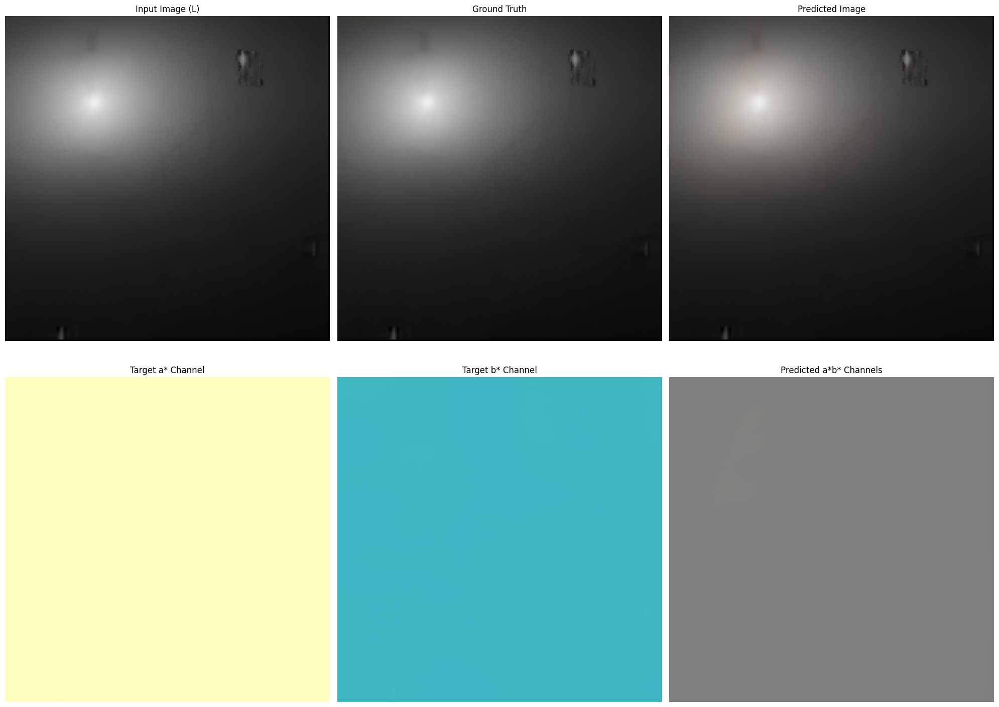

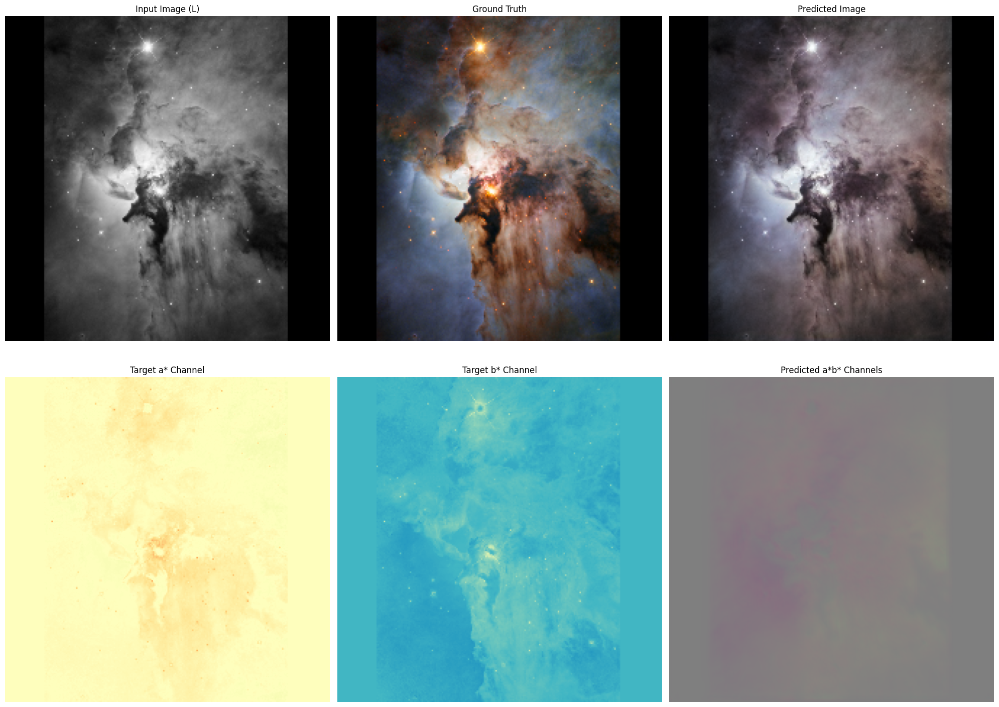

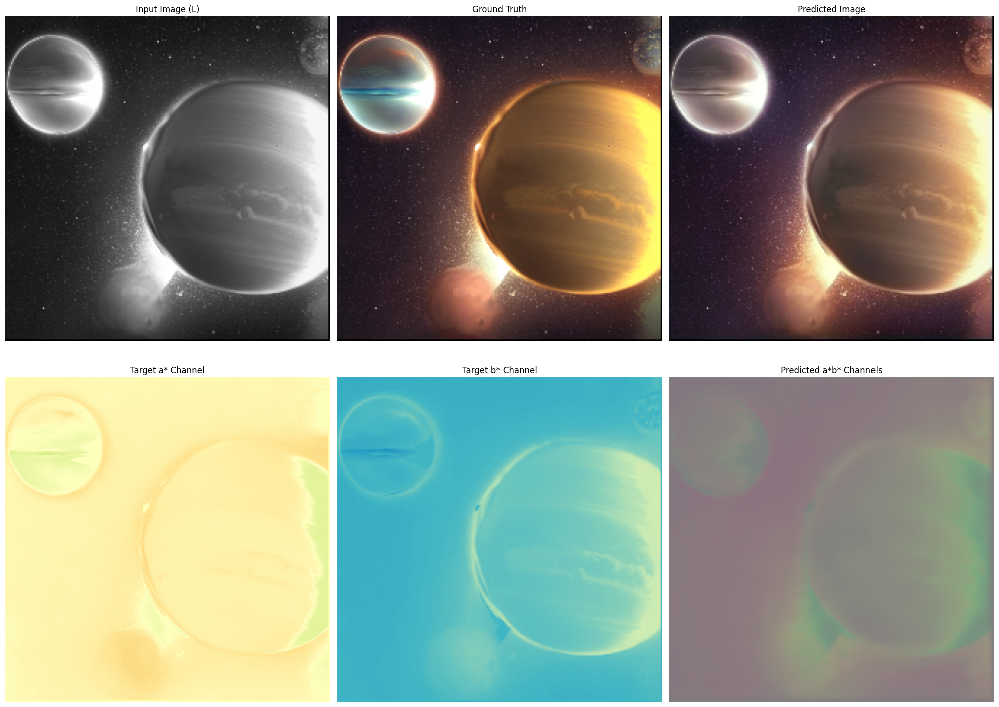

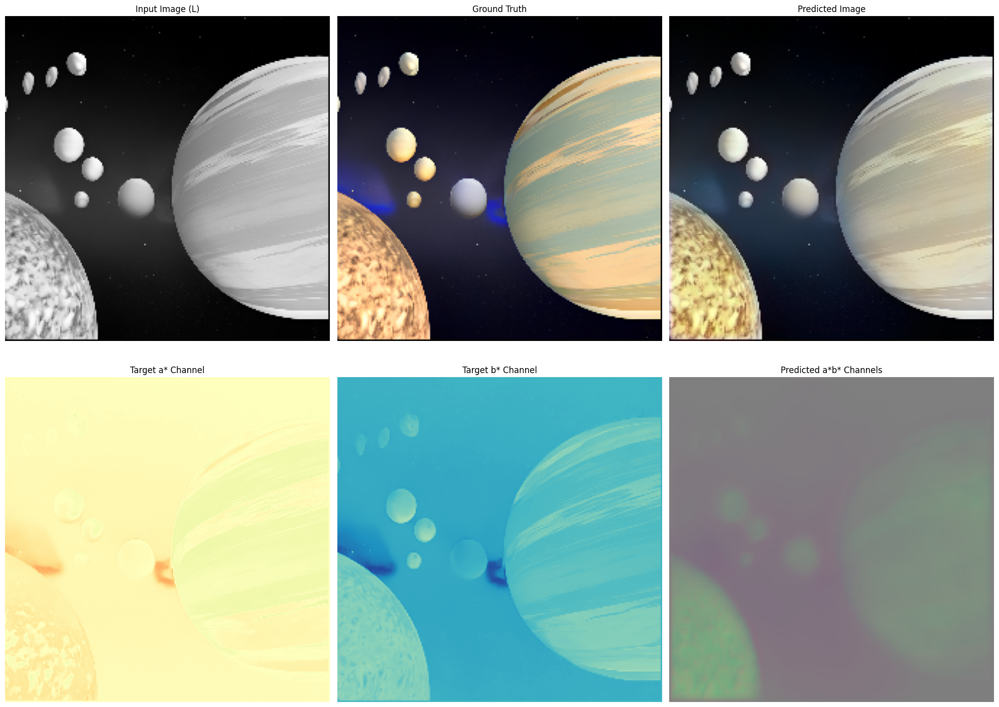

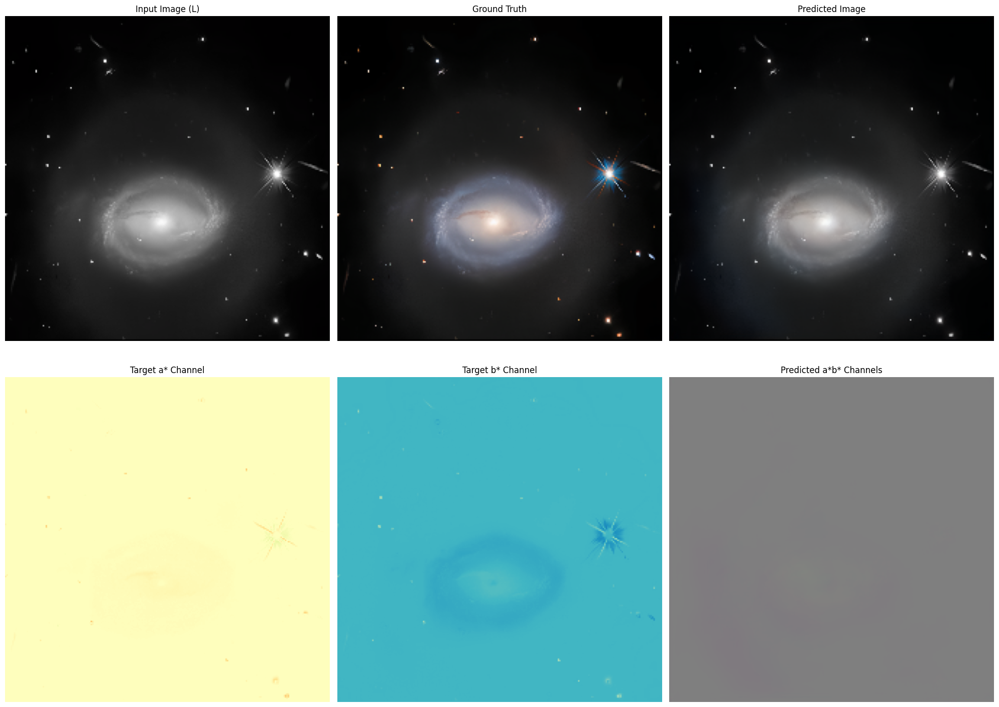

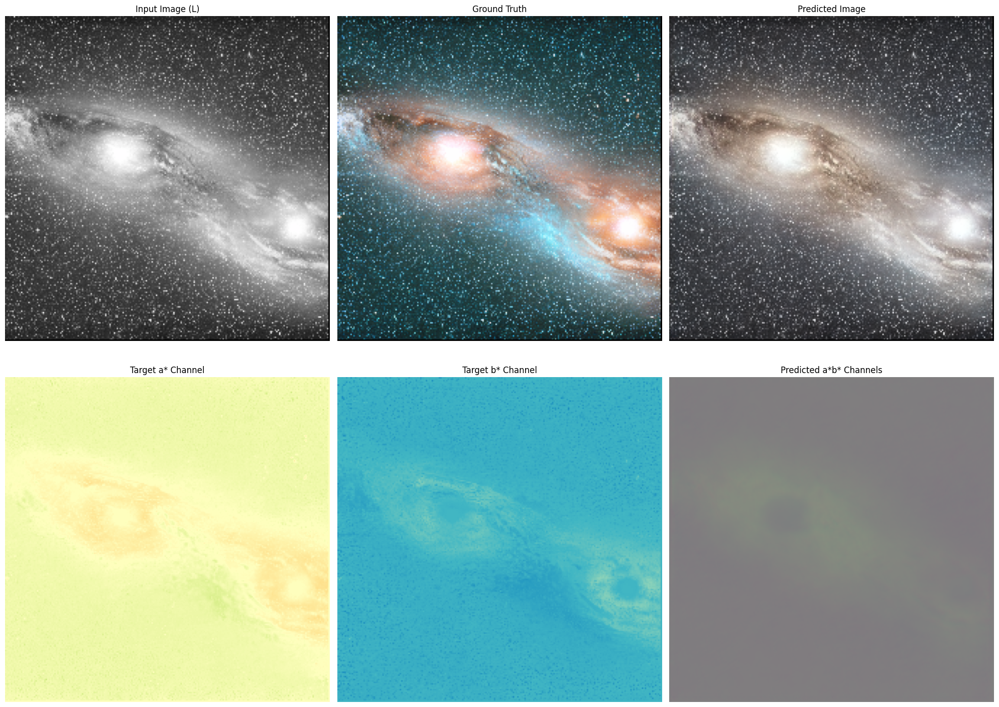

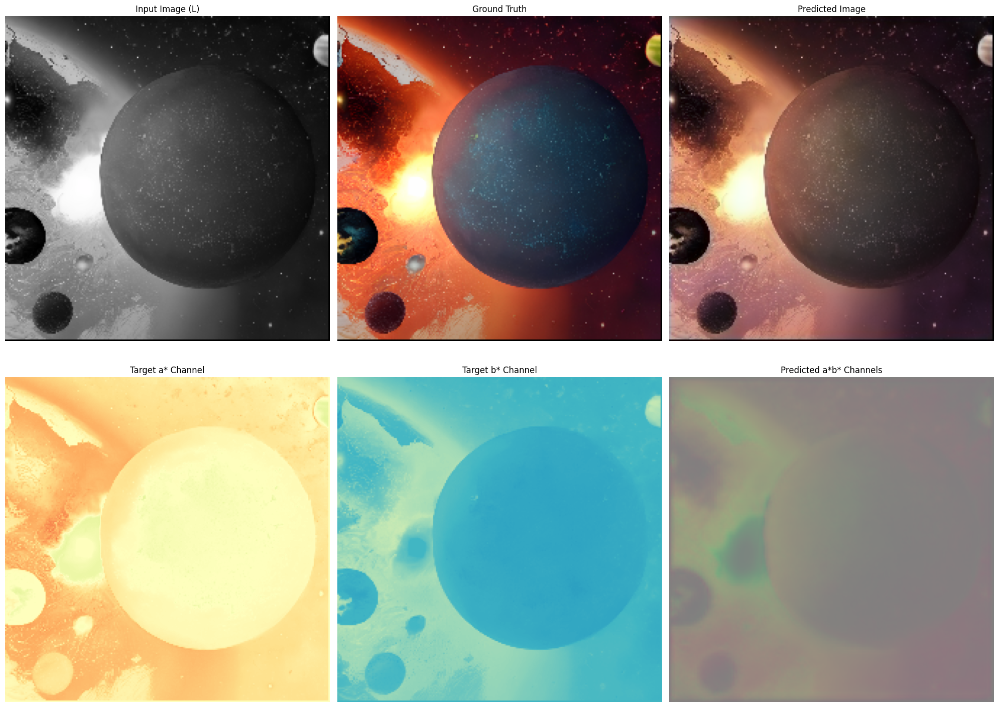

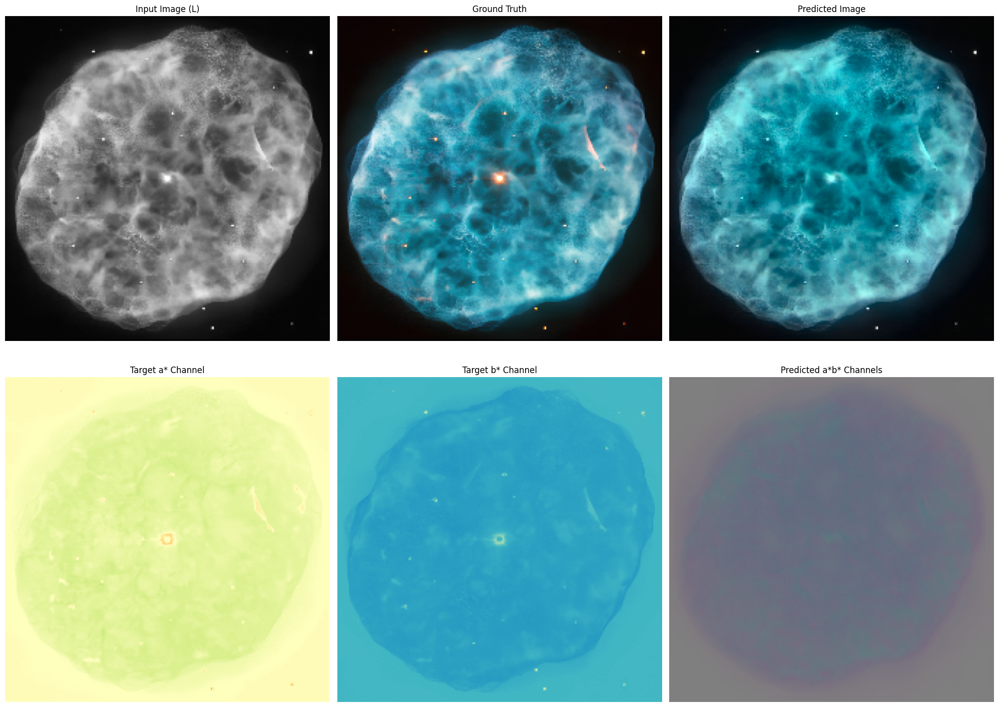

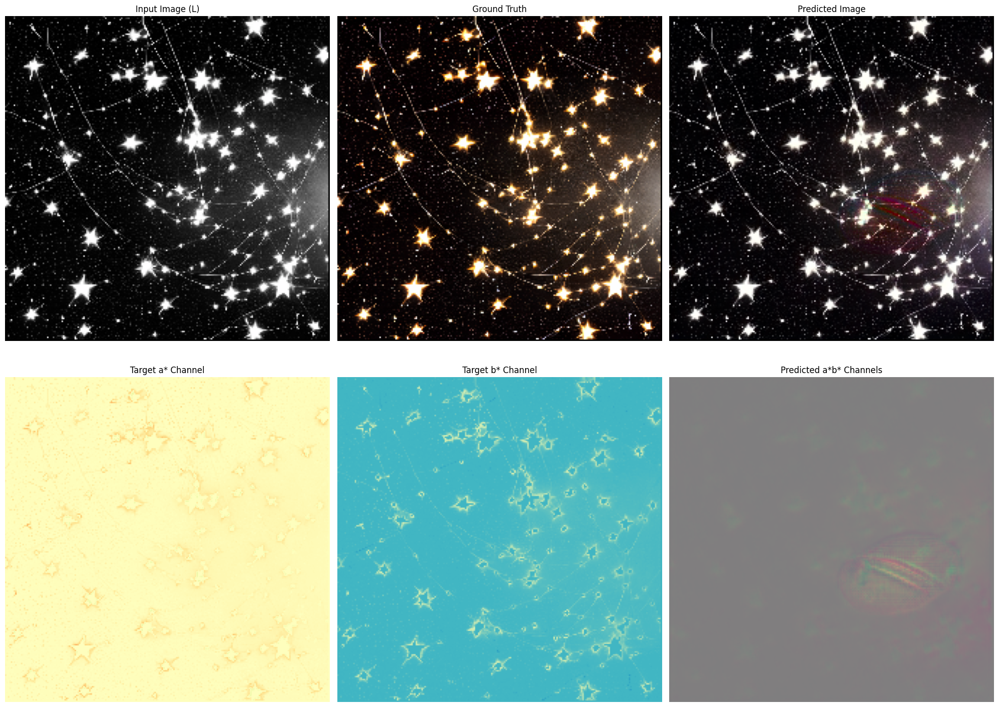

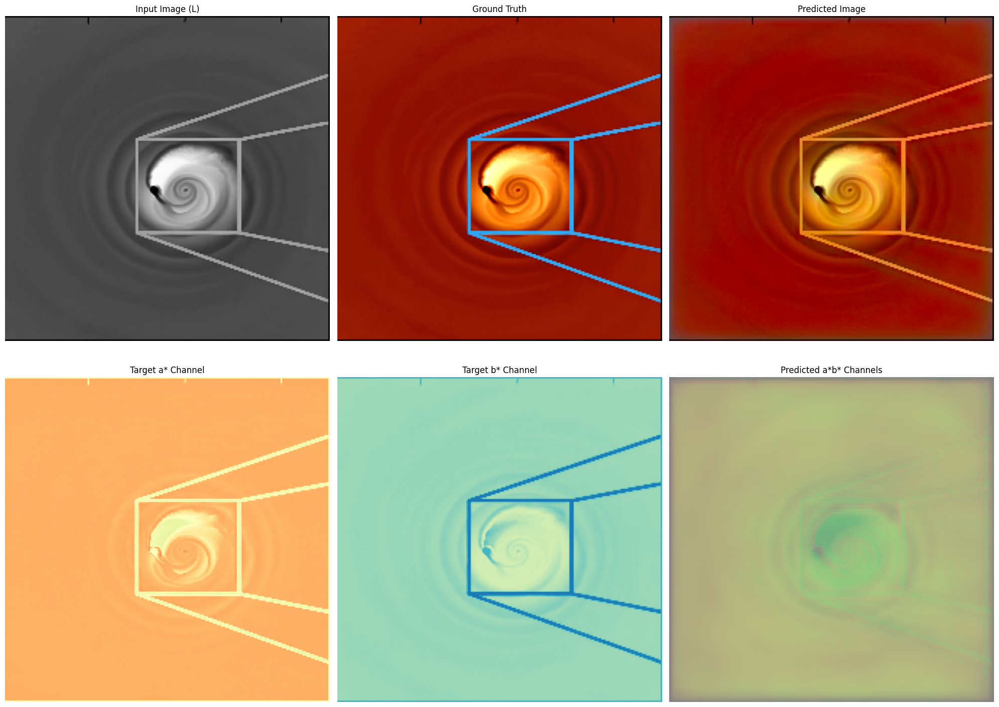

In [24]:
for inp, tar in test_dataset.take(10):
    generate_images(generator, inp, tar)